In [1]:
import numpy as np
import matplotlib.pyplot as plt

import json
from xml.etree.ElementTree import parse

import glob
import os 
import random
import cv2
import albumentations as A

## 데이터 라벨링 & 시각화

In [2]:
label_number_dict = {'cat' : 0, 'dog' : 1}
def xml_read(xml_path) : 
    root = parse(xml_path).getroot()
    image_info = root.findall('image')
    for image in image_info :
        bbox = image.findall('box')
        image_width = image.attrib['width']
        image_height= image.attrib['height']
        
        image_name = image.attrib['name']
        image_name_temp = image_name
        image_name = os.path.join('./data/', image_name)
        
        image = cv2.imread(image_name)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        for box_info in bbox : 
            label = box_info.attrib['label']
            
            xtl = int(float(box_info.attrib['xtl']))
            ytl = int(float(box_info.attrib['ytl']))
            xbr = int(float(box_info.attrib['xbr']))
            ybr = int(float(box_info.attrib['ybr']))
            
            image_width = int(image_width)
            image_height = int(image_height)
            
            center_x = ((xtl+xbr) / (2*image_width))
            center_y = ((ytl+ybr) / (2*image_height))
            yolo_w = (xbr-xtl) / image_width
            yolo_h = (ybr-ytl) / image_height
            
            image_name_temp = image_name_temp.replace('.jpg', '')
            label_number = label_number_dict[label]
            print(f"Pascal_xyxy to YOLO : {label_number}, {center_x}, {center_y}, {yolo_w}, {yolo_h}")
            
            with open(f"{image_name_temp}.txt", "a") as f :
                f.write(f"{label_number}, {center_x}, {center_y}, {yolo_w}, {yolo_h}\n")
xml_read('./data/annotations.xml')

Pascal_xyxy to YOLO : 1, 0.865625, 0.45, 0.26875, 0.5166666666666667
Pascal_xyxy to YOLO : 0, 0.16171875, 0.6041666666666666, 0.3140625, 0.44583333333333336


In [3]:
json_dir = "./anno/"
json_paths = glob.glob(os.path.join(json_dir, "*.json"))
label_dict = {"수각류" : 0}

for json_path in json_paths : 
    with open(json_path, 'r', encoding='utf-8') as f :
        json_data = json.load(f)
        
    images_info = json_data['images']
    annotations_info = json_data['annotations']
    
    filename = images_info['filename']
    image_id = images_info['id']
    image_width = images_info['width']
    image_height = images_info['height']
    
    new_width = 1024
    new_height = 768
    for ann_info in annotations_info :
        if image_id == ann_info['image_id'] :
            image_path = os.path.join("./images/", filename)
            image = cv2.imread(image_path)
            
            scale_x = new_width / image.shape[1] 
            scale_y = new_height / image.shape[0] 
            resized_image = cv2.resize(image, (new_width, new_height))
            category_name = ann_info['category_name']
            polygons = ann_info['polygon']
            
            points = []
            for polygon_info in polygons :
                x = polygon_info['x']
                y = polygon_info['y']
                resized_x = int(x * scale_x)
                resized_y = int(y * scale_y)
                points.append((resized_x, resized_y))
                
            cv2.polylines(resized_image, [np.array(points, np.int32).reshape((-1,1,2))], isClosed=True, color=(0,255,0), thickness=2)
            
            x_coords = [point[0] for point in points]
            y_coords = [point[1] for point in points]
            x_min = min(x_coords)
            y_min = min(y_coords)
            x_max = max(x_coords)
            y_max = max(y_coords)
            
            cv2.rectangle(resized_image, (x_min,y_min), (x_max, y_max), (0,0,255), 2)
            
            center_x = ((x_max+x_min) / (2*new_width))
            center_y = ((y_max+y_min) / (2*new_height))
            yolo_w = (x_max-x_min) / new_width
            yolo_h = (y_max-y_min) / new_height
            

            image_name_temp = filename.replace(".jpg", "")
            label_number = label_dict[category_name]

        os.makedirs('./yolo_label_data', exist_ok=True)
        with open(f"./yolo_label_data/{image_name_temp}.txt", "a") as f :
            f.write(f"{label_number} {center_x} {center_y} {yolo_w} {yolo_h}\n")

#         cv2.imshow("Polygon", resized_image)

#         if cv2.waitKey(0) & 0xFF == ord('q') : 
#             exit()

## Image Augmentation

### 회전

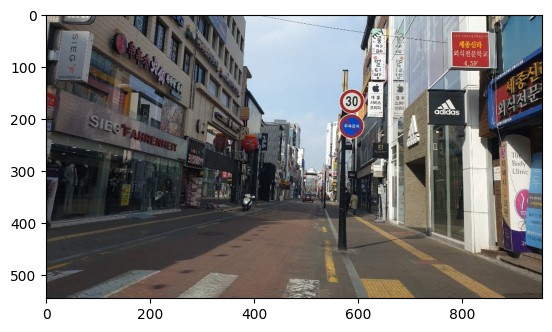

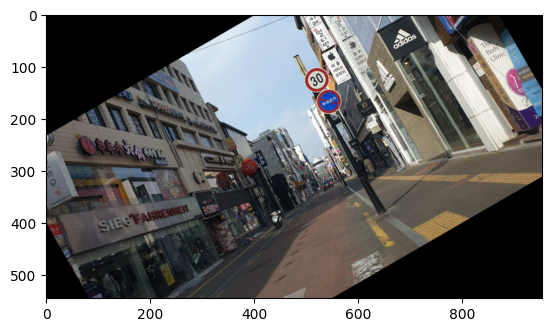

In [4]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
angle = 30
(h, w) = image.shape[:2]
center = (w // 2, h // 2)
M = cv2.getRotationMatrix2D(center, angle, 1.0)
rotated = cv2.warpAffine(image, M, (w,h))

plt.imshow(image)
plt.show()

plt.imshow(rotated)
plt.show()

### 이동

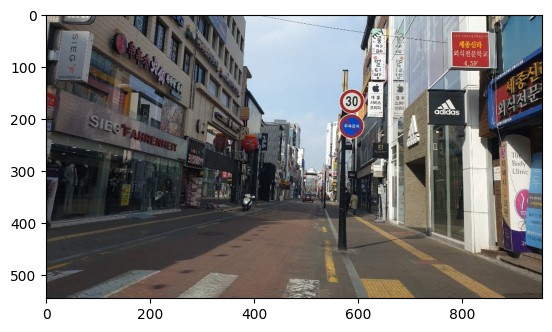

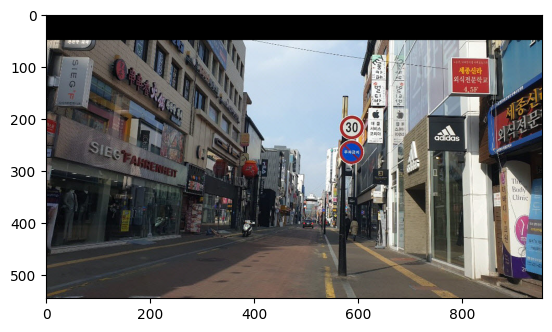

In [5]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
shift = (0,50)
M = np.float32([[1, 0, shift[0]], [0, 1, shift[1]]])
shifted = cv2.warpAffine(image, M, (image.shape[1], image.shape[0]))

plt.imshow(image)
plt.show()

plt.imshow(shifted)
plt.show()

### Zoom

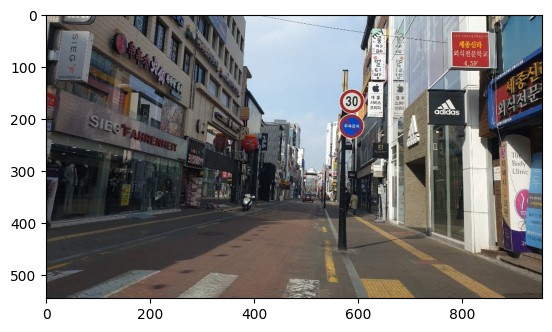

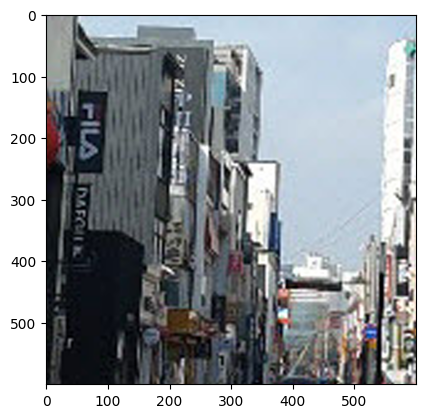

In [6]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
height,  width = image.shape[:2]
zoom_scale = 4
enlarged_img = cv2.resize(image, (width*zoom_scale, height*zoom_scale), interpolation=cv2.INTER_CUBIC)
center = [enlarged_img.shape[0] // 2, enlarged_img.shape[1] // 2]
cut_half = 300
zoomed_img = enlarged_img[center[0]-cut_half:center[0]+cut_half, center[1]-cut_half:center[1]+cut_half]
                          
plt.imshow(image)
plt.show()

plt.imshow(zoomed_img)
plt.show()

### 반전(Flip)

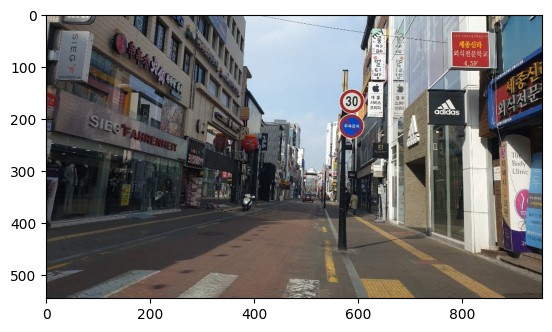

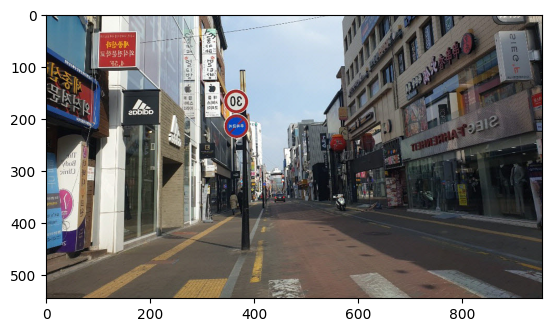

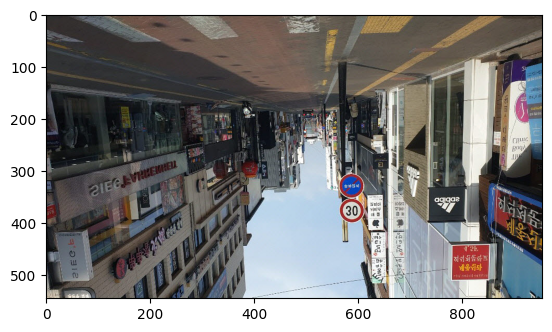

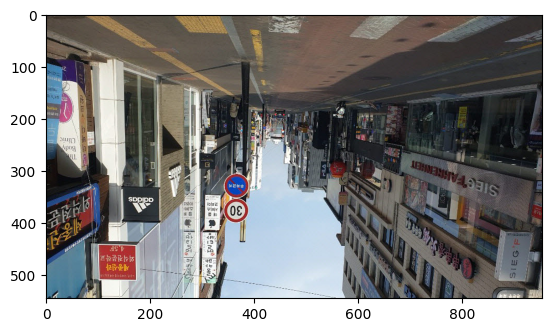

In [7]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
flipped1 = cv2.flip(image,1)
flipped2 = cv2.flip(image,0)
flipped3 = cv2.flip(image,-1)

plt.imshow(image)
plt.show()

plt.imshow(flipped1)
plt.show()

plt.imshow(flipped2)
plt.show()

plt.imshow(flipped3)
plt.show()

### 노이즈 추가

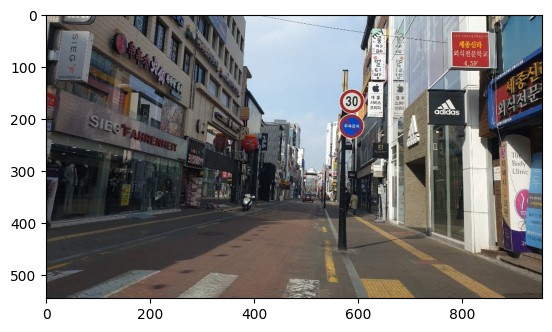

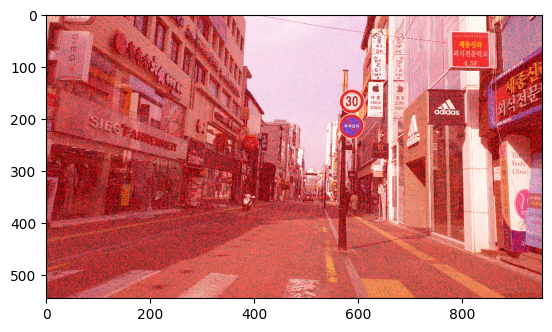

In [8]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
noise = np.zeros(image.shape, np.uint8) 
cv2.randu(noise, 0, 255)
black = noise < 30
white = noise > 225
noise[black] = 0
noise[white] = 255

noise_b = noise[:, :, 0]
noise_g = noise[:, :, 1]
noise_r = noise[:, :, 2]
noisy_img = cv2.merge([cv2.add(image[:,:,0], noise_b),
                       cv2.add(image[:,:,1], noise_g),
                       cv2.add(image[:,:,2], noise_r)])

plt.imshow(image)
plt.show()

plt.imshow(noisy_img)
plt.show()

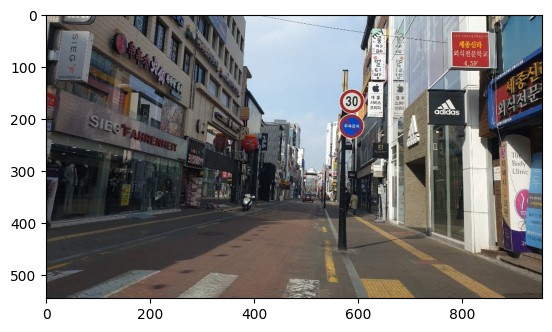

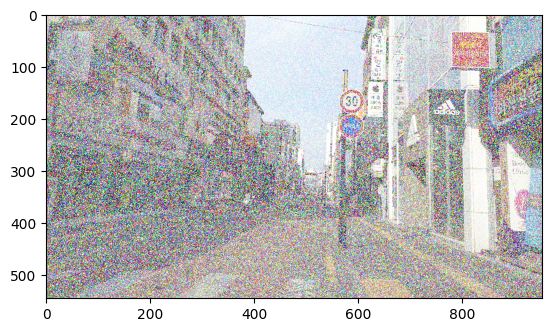

In [9]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
mean = 0 
var = 100 
sigma = var ** 0.5
gauss = np.random.normal(mean, sigma, image.shape)
gauss  = gauss.astype('uint8')
noisy_img = cv2.add(image, gauss)

plt.imshow(image)
plt.show()

plt.imshow(noisy_img)
plt.show()

### 색조 변경

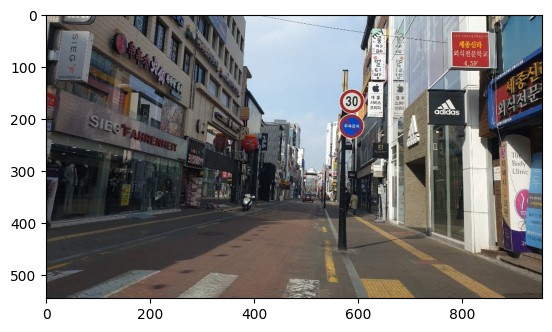

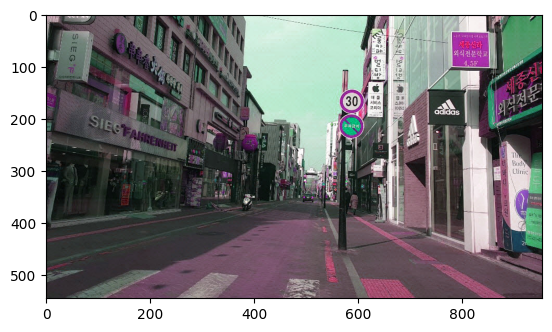

In [10]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
hue_shift = 30
hsv_img[:, :, 0] = (hsv_img[:, :, 0] + hue_shift) % 180
bgr_img = cv2.cvtColor(hsv_img, cv2.COLOR_HSV2BGR)

plt.imshow(image)
plt.show()

plt.imshow(bgr_img)
plt.show()

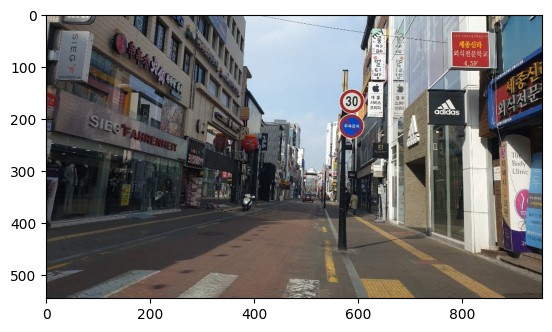

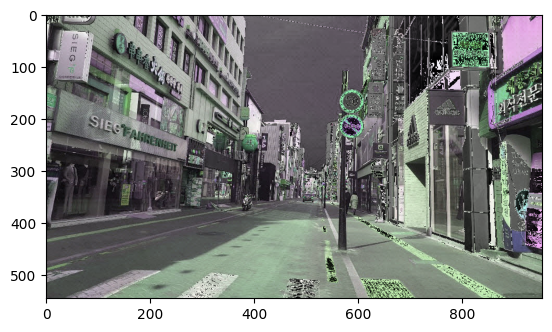

In [11]:
image = cv2.imread('./data/image02.jpeg')
hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
hsv_img[:, :, 0] += 50 
hsv_img[:, :, 1] = np.uint8(np.float32(hsv_img[:, :, 1]) * 0.5)
hsv_img[:, :, 2] = np.uint8(np.float32(hsv_img[:, :, 2]) * 1.5) 
bgr_img = cv2.cvtColor(hsv_img, cv2.COLOR_HSV2BGR)
rgb_img = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.imshow(image)
plt.show()

plt.imshow(bgr_img)
plt.show()

### 이미지 Crop

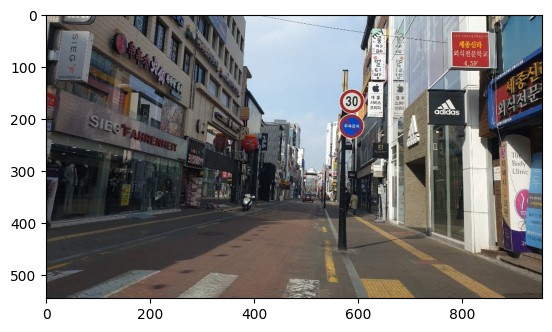

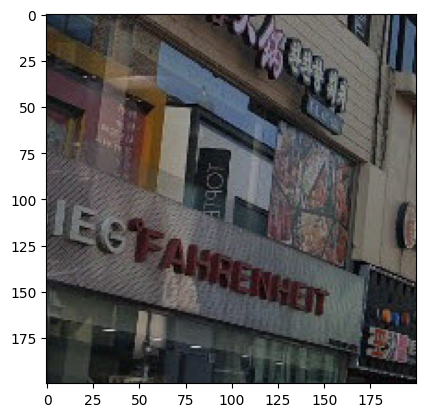

In [12]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
x, y, w, h = 100, 100, 200, 200
crop_img = image[y:y+h, x:x+w]

plt.imshow(image)
plt.show()

plt.imshow(crop_img)
plt.show()

### cv2.warpAffine()

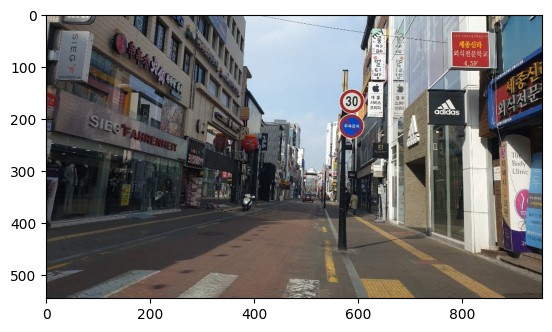

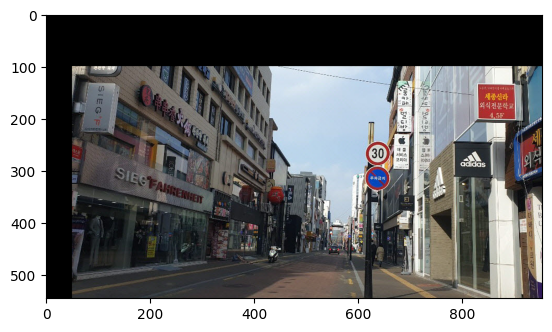

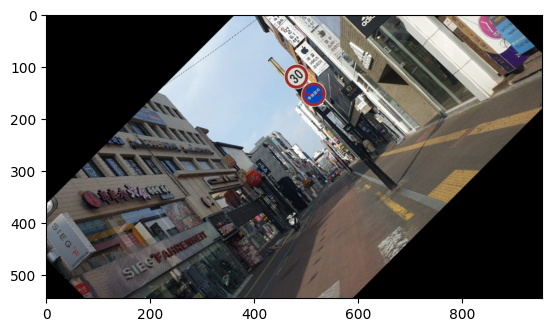

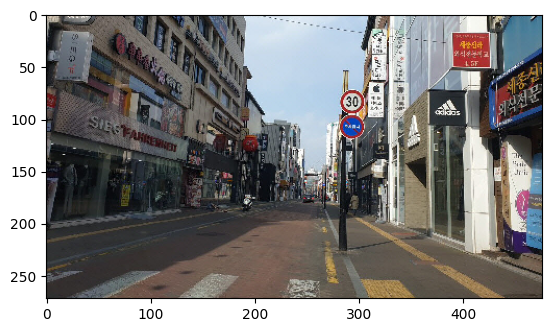

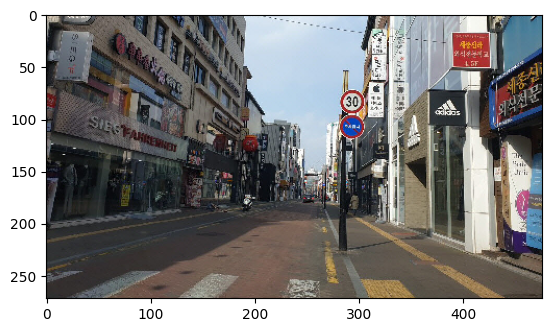

In [13]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

x_diff = 50
y_diff = 100
h, w, c = image.shape
M = np.float32([[1, 0 , x_diff], [0, 1 , y_diff]]) # x 축으로 50, y 축으로 100 이동하는 병진이동 행렬
shifted_img = cv2.warpAffine(image, M, (w, h))

M = cv2.getRotationMatrix2D((w//2, h//2), 45, 1)
rotated_img = cv2.warpAffine(image, M, (w,h))

M = cv2.getRotationMatrix2D((w//2, h//2), 0, 0.5)
halfed_img = cv2.warpAffine(image, M, (w,h))
cropped_img = halfed_img[h//2 - h//4 : h//2 + h//4, w//2 - w//4 : w//2 + w//4]

resized_img = cv2.resize(image, (w//2,h//2), interpolation=cv2.INTER_AREA)

plt.imshow(image)
plt.show()

plt.imshow(shifted_img)
plt.show()

plt.imshow(rotated_img)
plt.show()

plt.imshow(cropped_img)
plt.show()

plt.imshow(cropped_img)
plt.show()

### 블러

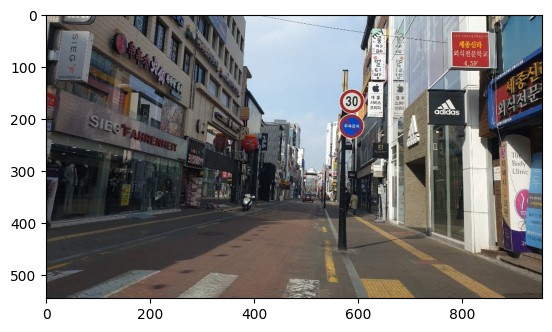

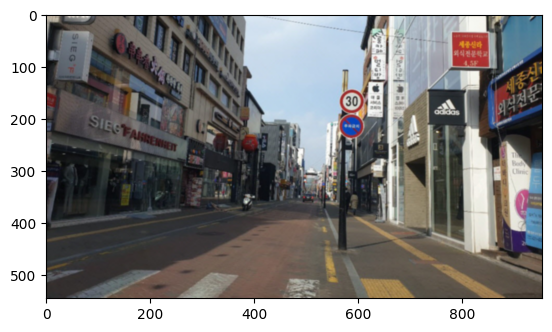

In [14]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

blur = cv2.GaussianBlur(image, (5,5), 0)

plt.imshow(image)
plt.show()

plt.imshow(blur)
plt.show()

### adaptiveThreshold

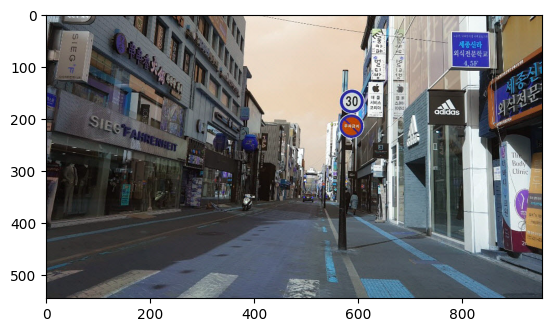

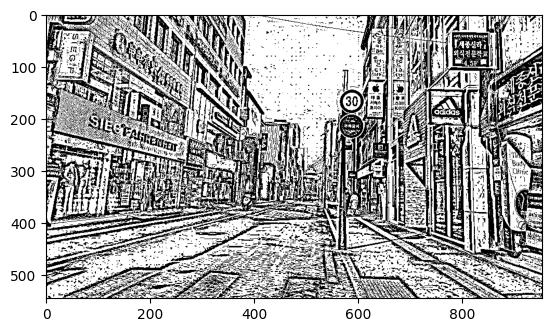

In [15]:
image = cv2.imread('./data/image02.jpeg')
img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

thresh = cv2.adaptiveThreshold(img_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)

plt.imshow(image, 'gray')
plt.show()

plt.imshow(thresh, 'gray')
plt.show()

### 색상 보정

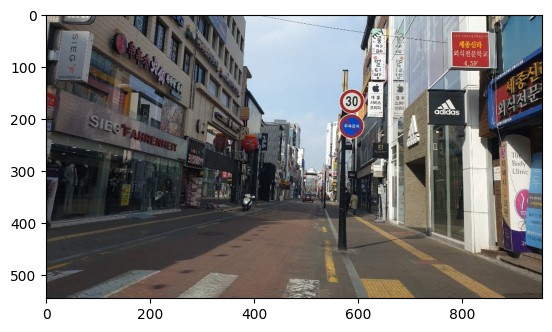

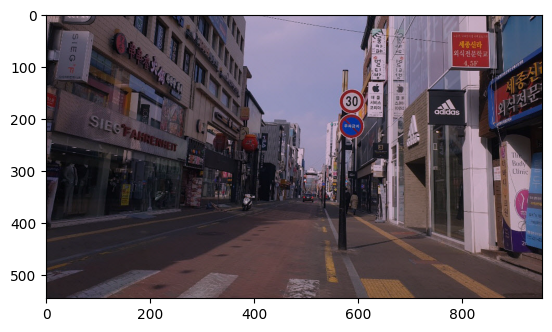

In [16]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

org_img = image.copy()
balance = [0.8, 0.7, 0.8]

for i, value in enumerate(balance) :
    if value != 1.0 :
        org_img[:,:,i] = cv2.addWeighted(org_img[:,:,i], value, 0, 0, 0)

plt.imshow(image)
plt.show()

plt.imshow(org_img)
plt.show()

### 모션 블러

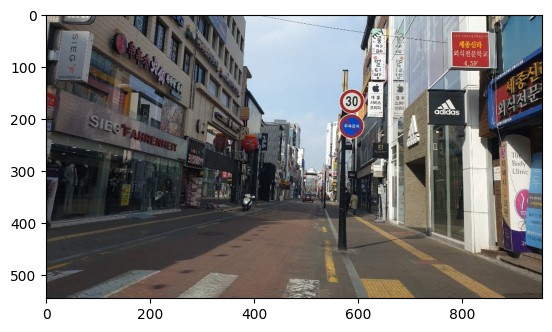

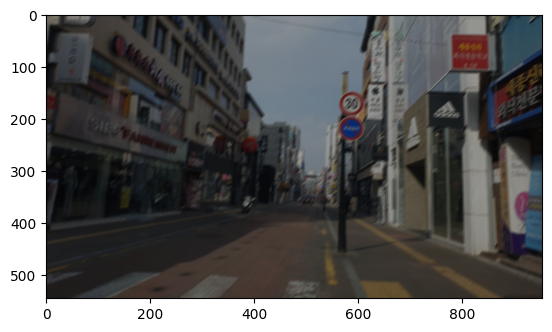

In [17]:
image = cv2.imread('./data/image02.jpeg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

kernel_size = 15
kernel_direction = np.zeros((kernel_size, kernel_size))
kernel_direction[int(kernel_size//2), :] = np.ones(kernel_size)
kernel_direction /= kernel_size # 커널의 합1이 1이 되도록
kernel_matrix = cv2.getRotationMatrix2D((kernel_size/2, kernel_size/2), 45, 1)
kernel = np.hstack((kernel_matrix[:, :2], [[0], [0]])) # 회전 매트릭스와 오프셋 벡터 결합하여 2x3 매트릭스 생성
kernel = cv2.warpAffine(kernel_direction, kernel, (kernel_size, kernel_size))

motion_blur = cv2.filter2D(image, -1, kernel)

plt.imshow(image)
plt.show()

plt.imshow(motion_blur)
plt.show()

### Random Noise

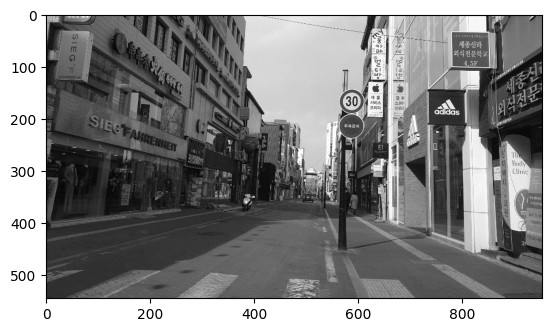

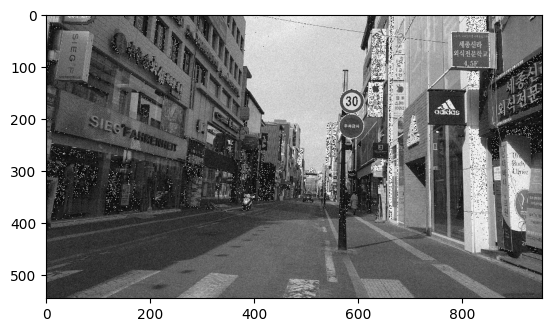

In [18]:
image = cv2.imread('./data/image02.jpeg')
gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

h, w = gray_img.shape

mean = 0 
var = 100 
sigma = var ** 0.5
gaussian = np.random.normal(mean, sigma, (h,w))
noisy_image = gray_img + gaussian.astype(np.uint8)

plt.imshow(gray_img, 'gray')
plt.show()

plt.imshow(noisy_image, 'gray')
plt.show()

### 채도 & 광도

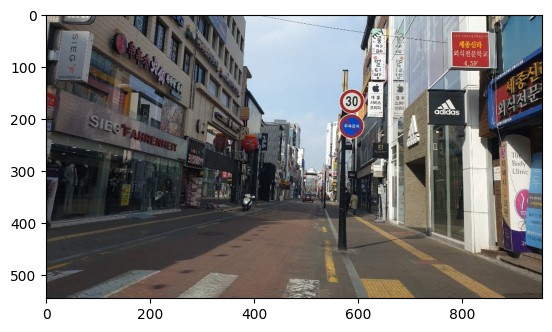

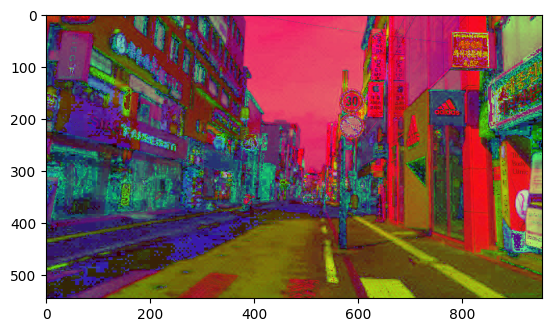

In [19]:
img = cv2.imread('./data/image02.jpeg')
org_img = img.copy()
org_img = cv2.cvtColor(org_img, cv2.COLOR_BGR2RGB)
hsv_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

saturation_factor = 1.5
hsv_img[:,:,1] = hsv_img[:,:,1] * saturation_factor
img_saturated = cv2.cvtColor(hsv_img, cv2.COLOR_HSV2BGR)
img_saturated = cv2.cvtColor(hsv_img, cv2.COLOR_BGR2RGB)

plt.imshow(org_img)
plt.show()

plt.imshow(img_saturated)
plt.show()

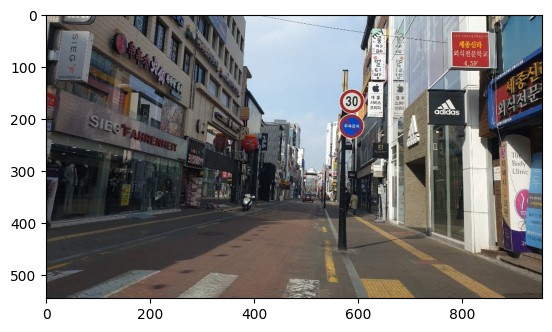

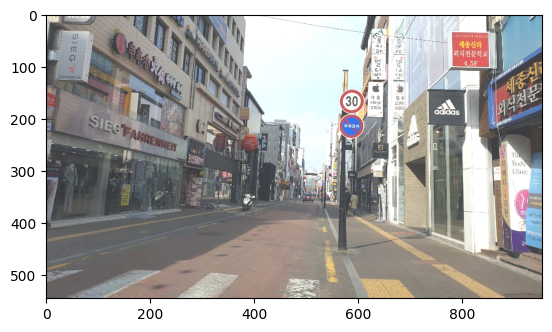

In [20]:
img = cv2.imread('./data/image02.jpeg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

brightness_offset = 50
img_brightened = cv2.convertScaleAbs(img, alpha=1, beta=brightness_offset)

plt.imshow(img)
plt.show()

plt.imshow(img_brightened)
plt.show()               

### 노이즈 제거

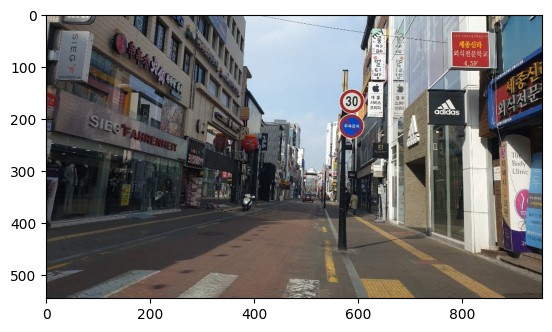

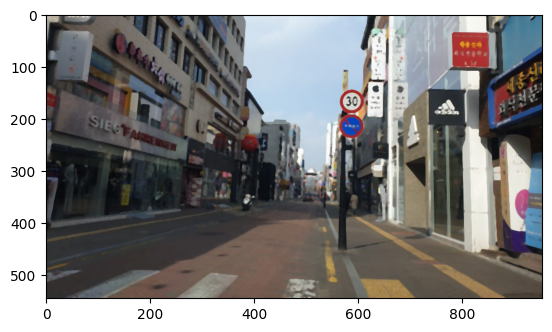

In [21]:
img = cv2.imread('./data/image02.jpeg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

img_filtered = cv2.medianBlur(img, 5)
 
plt.imshow(img)
plt.show()

plt.imshow(img_filtered)
plt.show()

### 히스토그램 균일화

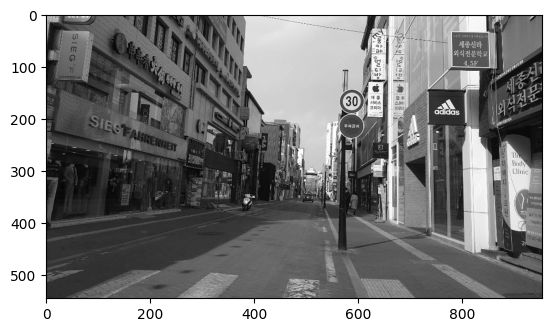

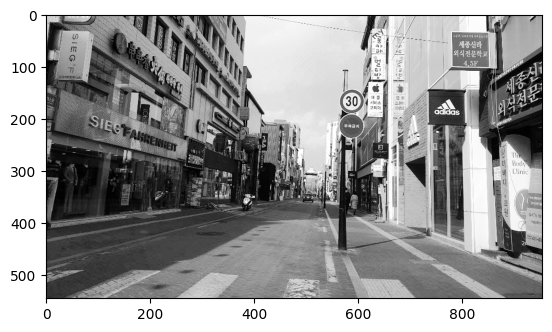

In [22]:
img = cv2.imread('./data/image02.jpeg', cv2.IMREAD_GRAYSCALE)
img_equalized = cv2.equalizeHist(img)

plt.imshow(img, 'gray')
plt.show()

plt.imshow(img_equalized, 'gray')
plt.show()

### Albumentation

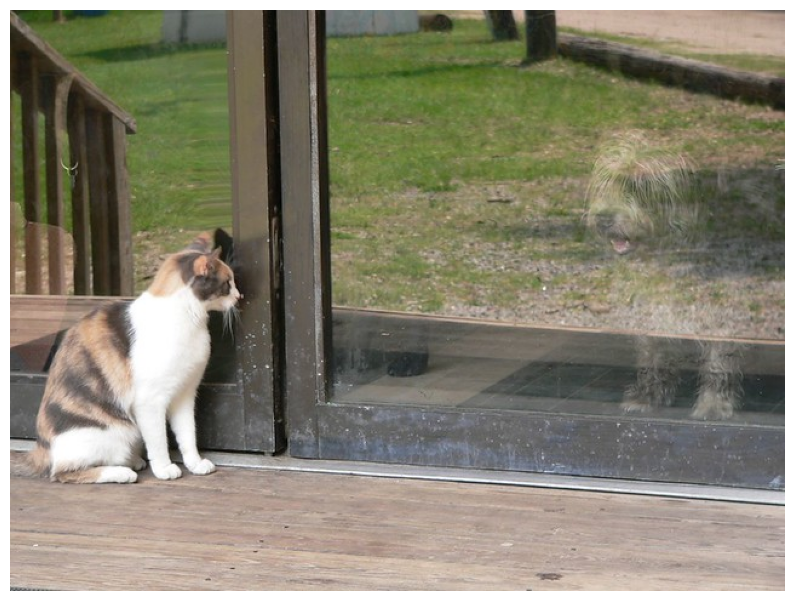

In [23]:
def visualize(image) :
    plt.figure(figsize=(10,10))
    plt.axis('off')
    plt.imshow(image)
    
image = cv2.imread('./data/01.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
visualize(image)

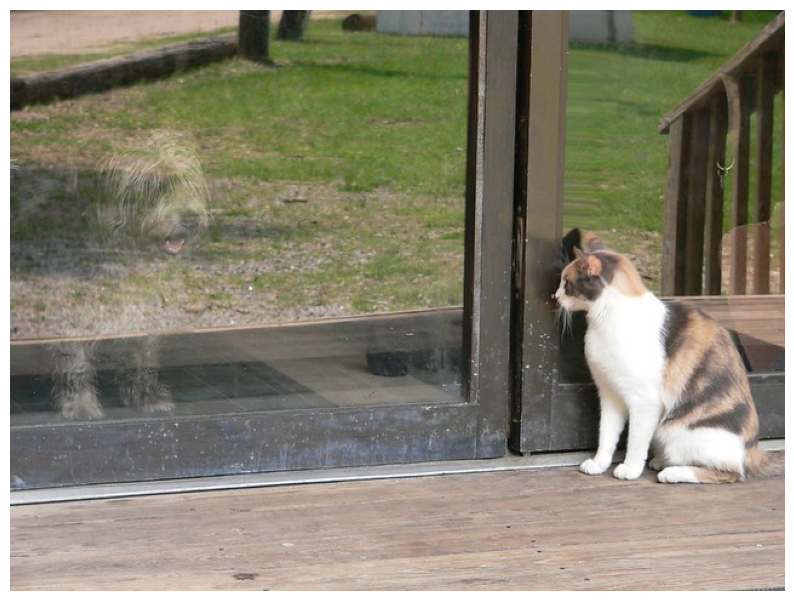

In [24]:
transform = A.HorizontalFlip(p=0.5)
random.seed(7)
augmented_image = transform(image=image)['image']
visualize(augmented_image)

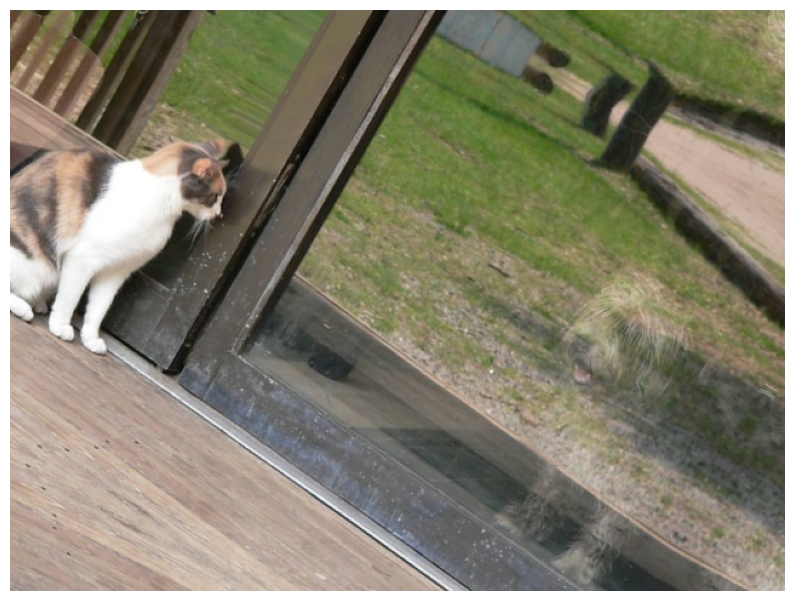

In [25]:
transform = A.ShiftScaleRotate(p=0.5)
random.seed(7)
augmented_image = transform(image=image)['image']
visualize(augmented_image)

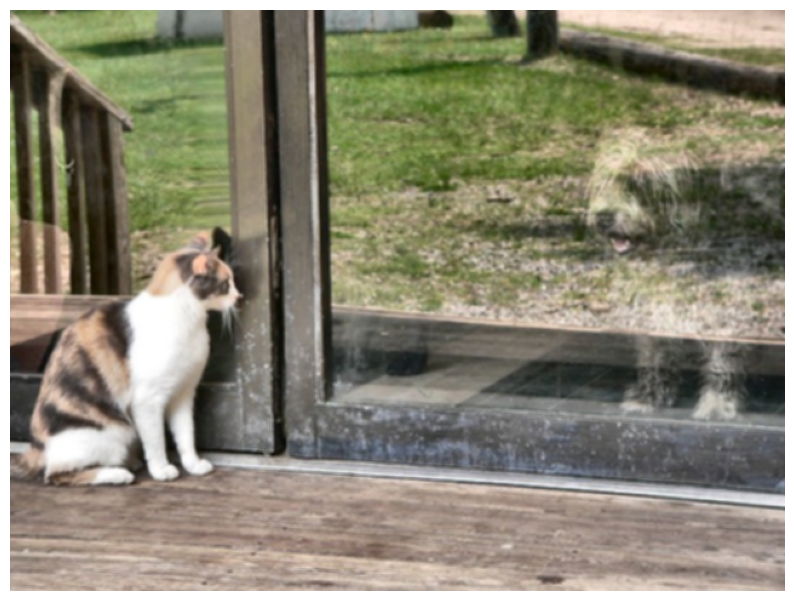

In [26]:
transform = A.Compose([
    A.CLAHE(),
    A.RandomRotate90(),
    A.Transpose(),
    A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.50, rotate_limit=45, p=.75),
    A.Blur(blur_limit=3),
    A.OpticalDistortion(),
    A.GridDistortion(),
    A.HueSaturationValue(),
])
random.seed(42)
augmented_image = transform(image=image)['image']
visualize(augmented_image)

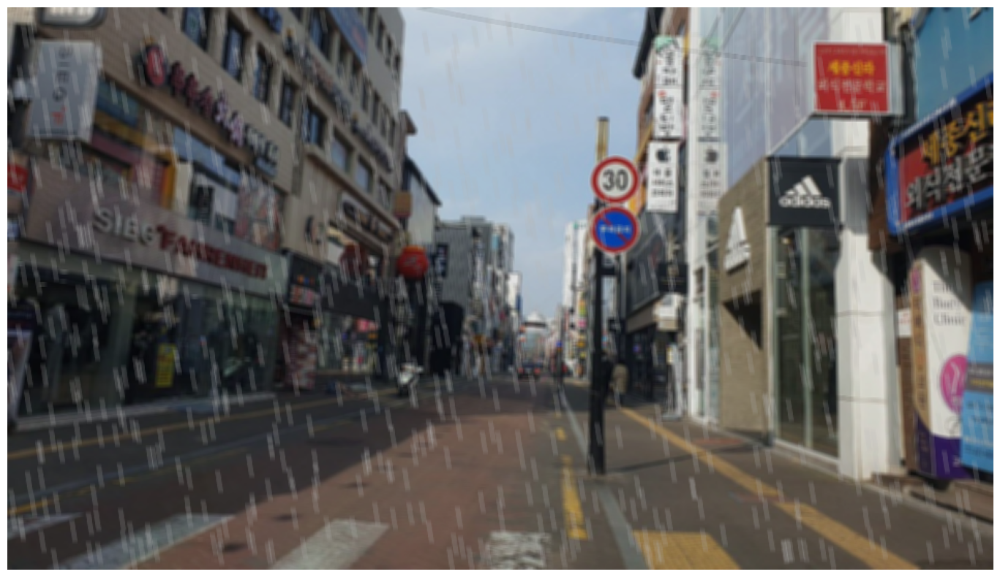

In [27]:
def visualize(image) :
    plt.figure(figsize=(20,10))
    plt.axis('off')
    plt.imshow(image)

image = cv2.imread("./data/image02.jpeg")    
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
transform = A.Compose([
    A.RandomRain(brightness_coefficient=0.9, drop_width=1, blur_value=5, p=1)
])  
random.seed(7)
transformed = transform(image=image)
visualize(transformed['image'])

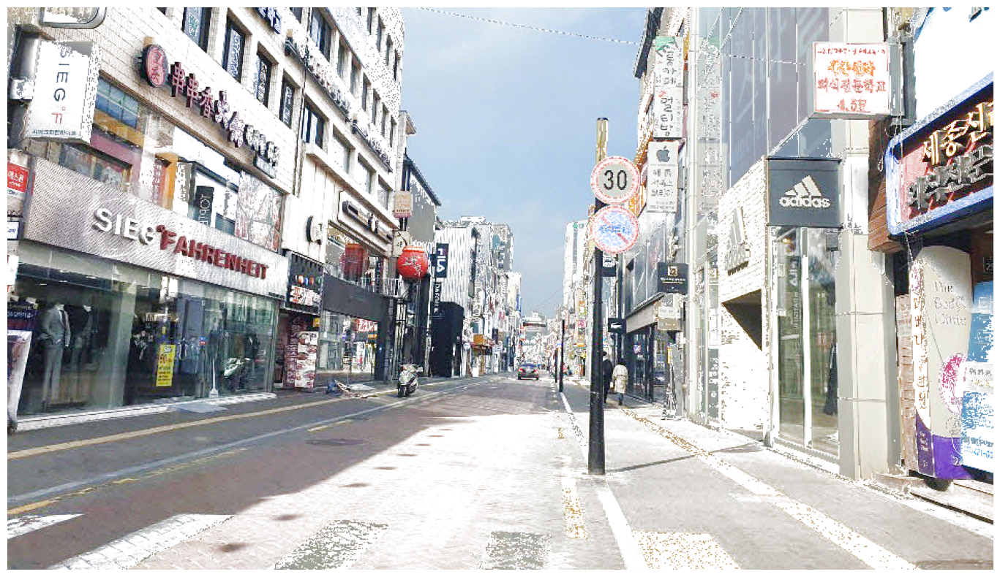

In [28]:
image = cv2.imread("./data/image02.jpeg")    
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
transform = A.Compose([
    A.RandomSnow(brightness_coeff=2.5, snow_point_lower=0.3, snow_point_upper=0.5, p=1)
])  
random.seed(7)
transformed = transform(image=image)
visualize(transformed['image'])

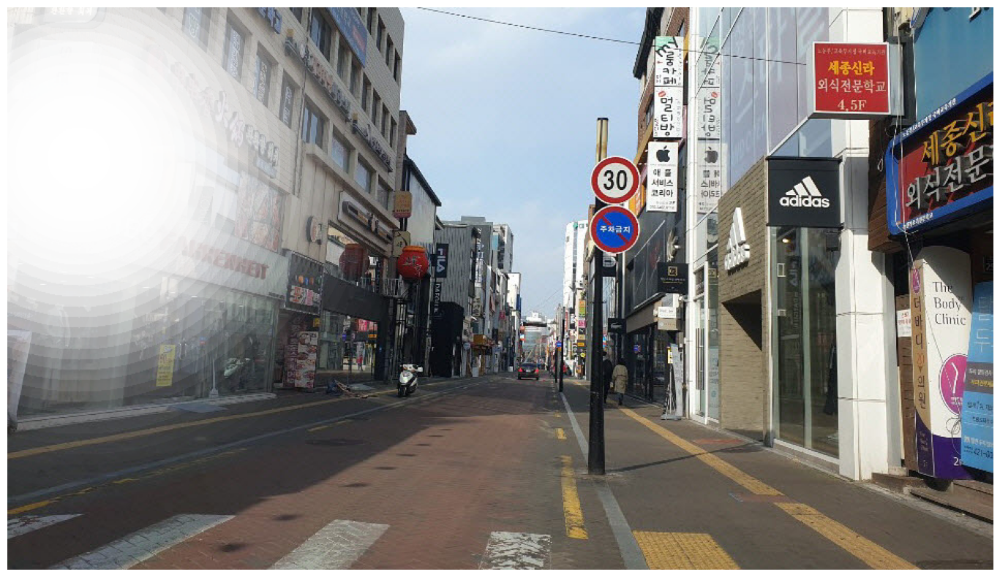

In [29]:
transform = A.Compose([
    A.RandomSunFlare(flare_roi=(0,0,1,0.5), angle_lower=0.5, p=1)
])
random.seed(7)
transformed = transform(image=image)
visualize(transformed['image'])

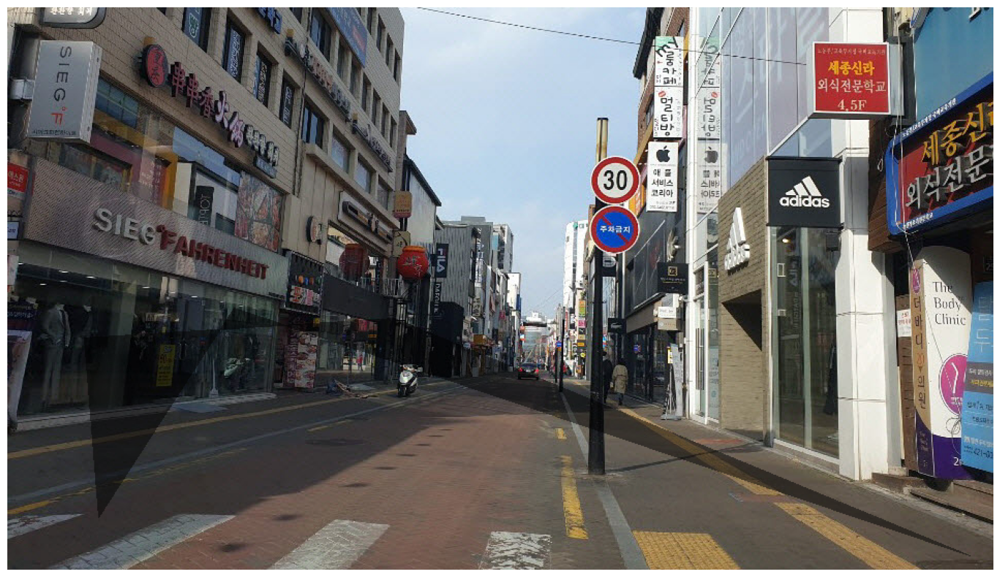

In [30]:
transform = A.Compose([
    A.RandomShadow(num_shadows_lower=1, num_shadows_upper=1, shadow_dimension=5, shadow_roi=(0,0.5,1,1), p=1)
])
random.seed(7)
transformed = transform(image=image)
visualize(transformed['image'])

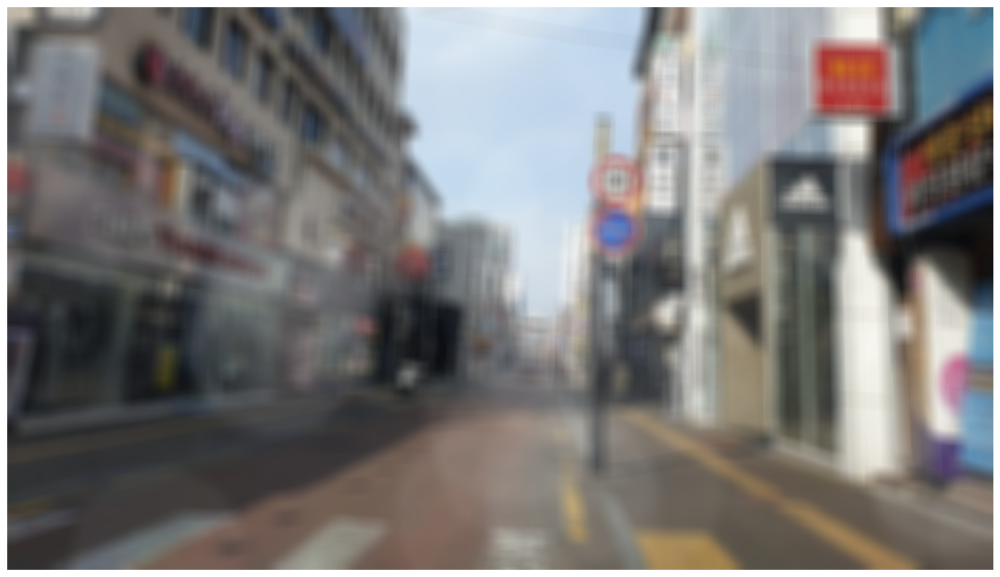

In [31]:
transform = A.Compose([
    A.RandomFog(fog_coef_lower=0.4, fog_coef_upper=0.6, alpha_coef=0.1, p=1)
])
random.seed(7)
transformed = transform(image=image)
visualize(transformed['image'])

### 바운딩 박스 그리기

In [32]:
BOX_COLOR = (255, 0, 0)
TEXT_COLOR = (255, 255, 255)

def visualize_bbox(img, bbox, class_name, color=BOX_COLOR, thickness=2):
    x_min, y_min, w, h = bbox
    x_min, x_max, y_min, y_max = int(x_min), int(x_min + w), int(y_min), int(y_min + h)

    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=color, thickness=thickness)

    ((text_width, text_height), _) = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.35, 1)    
    cv2.rectangle(img, (x_min, y_min - int(1.3 * text_height)), (x_min + text_width, y_min), BOX_COLOR, -1)
    cv2.putText(
        img,
        text=class_name,
        org=(x_min, y_min - int(0.3 * text_height)),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.35, 
        color=TEXT_COLOR, 
        lineType=cv2.LINE_AA,
    )
    return img

def visualize(image, bboxes, category_ids, category_id_to_name):
    img = image.copy()
    for bbox, category_id in zip(bboxes, category_ids):
        class_name = category_id_to_name[category_id]
        img = visualize_bbox(img, bbox, class_name)
    plt.figure(figsize=(12,12))
    plt.axis('off')
    plt.imshow(img)
    
image = cv2.imread("./data/01.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
bboxes = [[3.96, 183.38, 200.88, 214.03], [468.94, 92.01, 171.06, 248.45]]
category_ids = [0, 1]
category_id_to_name = {0: 'cat', 1: 'dog'}

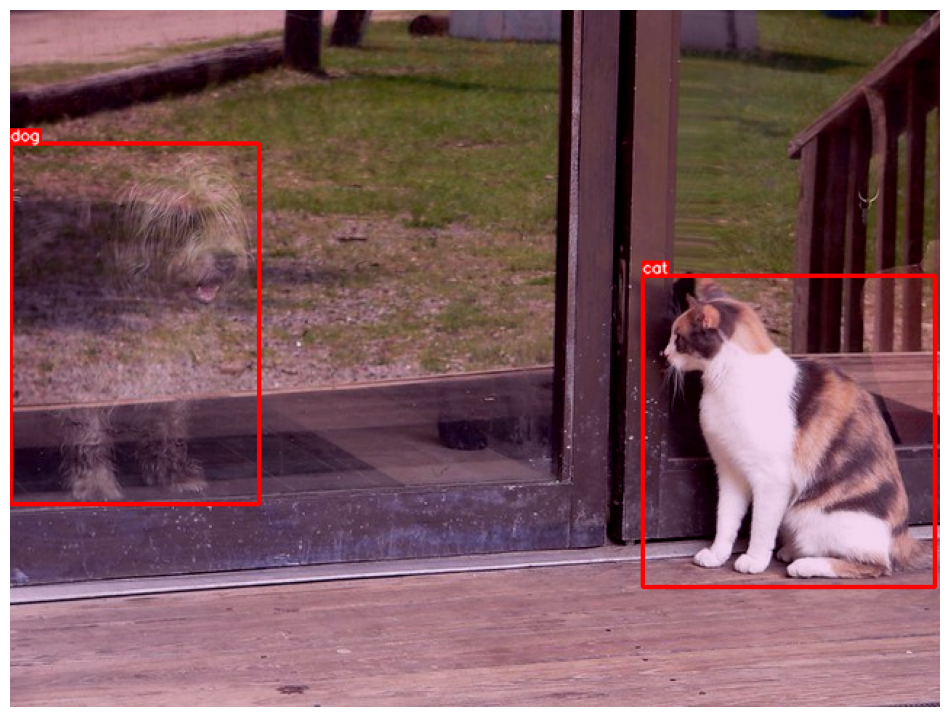

In [33]:
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.ShiftScaleRotate(p=0.5),
    A.RandomBrightnessContrast(p=0.3),
    A.RGBShift(r_shift_limit=30, g_shift_limit=30, b_shift_limit=30, p=0.3)
    ], 
    bbox_params=A.BboxParams(format='coco', label_fields=['category_ids']))
random.seed(7)
transformed = transform(image=image, bboxes=bboxes, category_ids=category_ids)
visualize(
    transformed['image'],
    transformed['bboxes'],
    transformed['category_ids'],
    category_id_to_name,
)

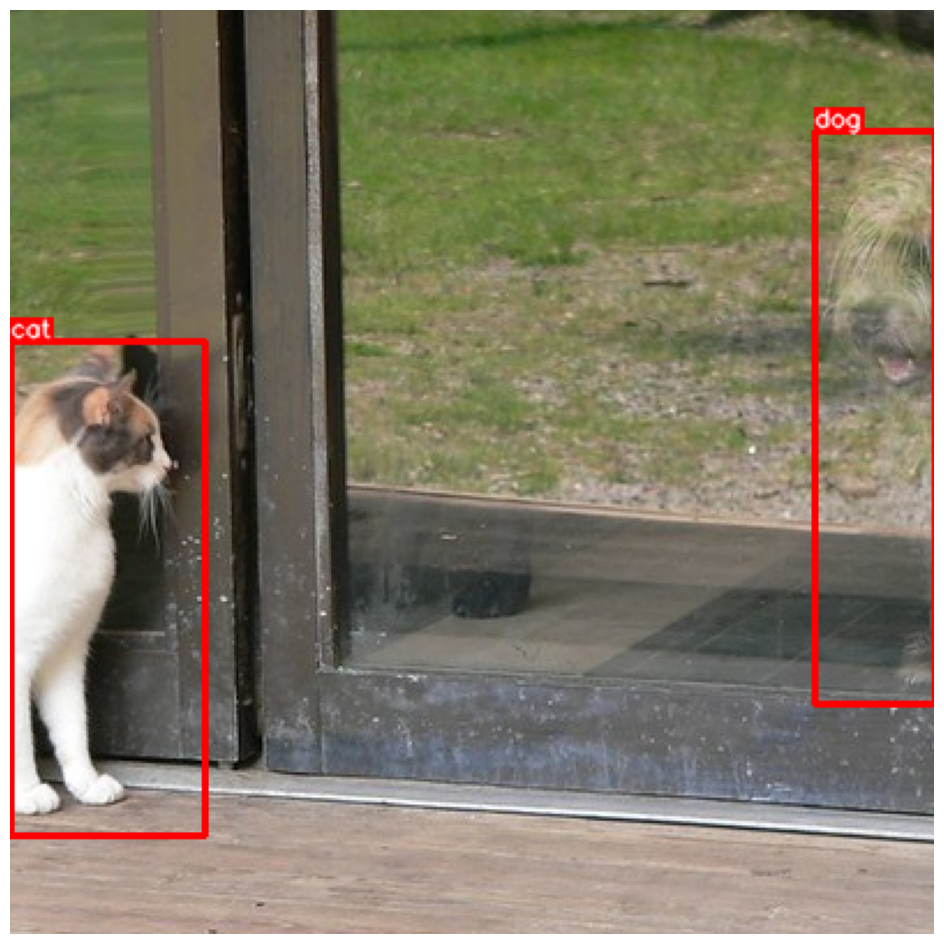

In [34]:
transform = A.Compose(
    [A.CenterCrop(height=400, width=400, p=1)], 
    bbox_params = A.BboxParams(format='coco', min_area=4500, label_fields=['category_ids']),
)

transformed = transform(image=image, bboxes=bboxes, category_ids=category_ids)
visualize(
    transformed['image'],
    transformed['bboxes'],
    transformed['category_ids'],
    category_id_to_name,
)

## 정형 데이터셋 나누기

In [35]:
import pandas as pd
from sklearn.model_selection import train_test_split

In [36]:
url = 'https://raw.githubusercontent.com/mGalarnyk/Tutorial_Data/master/King_County/kingCountyHouseData.csv'
df = pd.read_csv(url)
print(df)

               id             date     price  bedrooms  bathrooms   
0      7129300520  20141013T000000  221900.0         3       1.00  \
1      6414100192  20141209T000000  538000.0         3       2.25   
2      5631500400  20150225T000000  180000.0         2       1.00   
3      2487200875  20141209T000000  604000.0         4       3.00   
4      1954400510  20150218T000000  510000.0         3       2.00   
...           ...              ...       ...       ...        ...   
21608   263000018  20140521T000000  360000.0         3       2.50   
21609  6600060120  20150223T000000  400000.0         4       2.50   
21610  1523300141  20140623T000000  402101.0         2       0.75   
21611   291310100  20150116T000000  400000.0         3       2.50   
21612  1523300157  20141015T000000  325000.0         2       0.75   

       sqft_living  sqft_lot  floors  waterfront  view  ...  grade   
0             1180      5650     1.0           0     0  ...      7  \
1             2570      7242   

In [37]:
columns = ['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'price']
df = df.loc[:, columns]
print(df)

       bedrooms  bathrooms  sqft_living  sqft_lot  floors     price
0             3       1.00         1180      5650     1.0  221900.0
1             3       2.25         2570      7242     2.0  538000.0
2             2       1.00          770     10000     1.0  180000.0
3             4       3.00         1960      5000     1.0  604000.0
4             3       2.00         1680      8080     1.0  510000.0
...         ...        ...          ...       ...     ...       ...
21608         3       2.50         1530      1131     3.0  360000.0
21609         4       2.50         2310      5813     2.0  400000.0
21610         2       0.75         1020      1350     2.0  402101.0
21611         3       2.50         1600      2388     2.0  400000.0
21612         2       0.75         1020      1076     2.0  325000.0

[21613 rows x 6 columns]


In [38]:
features = ['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors']
target = ['price']
x_data = df.loc[:, features]
y_data = df.loc[:, target]
print(x_data)
print(y_data)

       bedrooms  bathrooms  sqft_living  sqft_lot  floors
0             3       1.00         1180      5650     1.0
1             3       2.25         2570      7242     2.0
2             2       1.00          770     10000     1.0
3             4       3.00         1960      5000     1.0
4             3       2.00         1680      8080     1.0
...         ...        ...          ...       ...     ...
21608         3       2.50         1530      1131     3.0
21609         4       2.50         2310      5813     2.0
21610         2       0.75         1020      1350     2.0
21611         3       2.50         1600      2388     2.0
21612         2       0.75         1020      1076     2.0

[21613 rows x 5 columns]
          price
0      221900.0
1      538000.0
2      180000.0
3      604000.0
4      510000.0
...         ...
21608  360000.0
21609  400000.0
21610  402101.0
21611  400000.0
21612  325000.0

[21613 rows x 1 columns]


In [39]:
X_train, X_test, y_train, y_test = train_test_split(x_data,y_data, random_state=777, test_size=0.2)
X_test, X_val, y_test, y_val = train_test_split(X_test,y_test, random_state=777, test_size=0.5)

print("---------변경되기 전 데이터 양---------")
print(f"x_data, y_data : {x_data.shape}, {y_data.shape}")
print("---------변경된 후 데이터 양---------")
print(f"X_train, y_train : {X_train.shape}, {y_train.shape}")
print(f"X_test, X_test : {X_test.shape}, {X_test.shape}")
print("---------Test, Val 나눈 후 데이터 양---------")
print(f"X_train, y_train : {X_train.shape}, {y_train.shape}")
print(f"X_test, y_test : {X_test.shape}, {y_test.shape}")
print(f"y_test, y_val : {X_val.shape}, {y_val.shape}")

---------변경되기 전 데이터 양---------
x_data, y_data : (21613, 5), (21613, 1)
---------변경된 후 데이터 양---------
X_train, y_train : (17290, 5), (17290, 1)
X_test, X_test : (2161, 5), (2161, 5)
---------Test, Val 나눈 후 데이터 양---------
X_train, y_train : (17290, 5), (17290, 1)
X_test, y_test : (2161, 5), (2161, 1)
y_test, y_val : (2162, 5), (2162, 1)


## Pytorch

In [40]:
import torch
import numpy as np

In [41]:
data = [[1,2], [3,4]]
x_data = torch.tensor(data)
print(x_data)

np_array = np.array(data)
x_np = torch.from_numpy(np_array)
print(x_np)

tensor([[1, 2],
        [3, 4]])
tensor([[1, 2],
        [3, 4]], dtype=torch.int32)


In [42]:
x_ones = torch.ones_like(x_data)
print(f"Ones Tersor :\n{x_ones}")

x_rand = torch.rand_like(x_data, dtype=torch.float) 
print(f"Random Tersor :\n{x_rand}")

Ones Tersor :
tensor([[1, 1],
        [1, 1]])
Random Tersor :
tensor([[0.9741, 0.3046],
        [0.4799, 0.2285]])


In [43]:
shape = (5,6,)
rand_tensor = torch.rand(shape) * 10 
ones_tensor = torch.ones(shape)
zeros_tensor = torch.zeros(shape)

print(f"rand_tensor :\n{rand_tensor}")
print(f"ones_tensor :\n{ones_tensor}")
print(f"zeros_tensor :\n{zeros_tensor}")

shape_temp = (5,6)
min_val = 6
max_val = 10
rand_tensor_temp = torch.rand(shape_temp) * (max_val - min_val) + min_val
print(rand_tensor_temp)

rand_tensor :
tensor([[4.2564, 1.4241, 1.7932, 5.4183, 1.7127, 8.2620],
        [8.2480, 7.7974, 0.3690, 9.5514, 7.8803, 7.0275],
        [6.1570, 7.8112, 0.4144, 5.8374, 5.8712, 2.6690],
        [1.0725, 8.0643, 2.2683, 4.3640, 9.1309, 0.4550],
        [1.3450, 7.1328, 1.8762, 7.5646, 6.4378, 7.9043]])
ones_tensor :
tensor([[1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1.]])
zeros_tensor :
tensor([[0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0.]])
tensor([[8.3028, 6.0813, 6.5869, 8.3644, 9.5024, 6.7396],
        [7.5922, 8.8412, 9.7300, 9.3254, 8.9523, 6.8896],
        [8.2090, 8.9671, 9.6552, 8.3516, 8.6770, 6.4188],
        [7.4373, 6.0256, 7.7121, 8.2628, 6.1087, 6.7257],
        [8.3786, 6.7625, 7.2359, 6.4718, 7.7098, 6.7625]])


In [44]:
tensor_val = torch.rand(3,4)

print(tensor_val)
print(f"Shape of tensor : {tensor_val.shape}")
print(f"Data type of tensor : {tensor_val.dtype}")
print(f"Device tensor is stored on on : {tensor_val.device}")
print(f"Dimension of tensor : {tensor_val.dim()}")

tensor([[0.3600, 0.8805, 0.9935, 0.9003],
        [0.2174, 0.6137, 0.0680, 0.8478],
        [0.5409, 0.9785, 0.5978, 0.8263]])
Shape of tensor : torch.Size([3, 4])
Data type of tensor : torch.float32
Device tensor is stored on on : cpu
Dimension of tensor : 2


In [45]:
tensor_1 = torch.ones(4,4)
tensor_1[:,3] = 0

tensor_2 = torch.ones(4,4)
tensor_2[:,1] = 2
print(tensor_1)

tensor([[1., 1., 1., 0.],
        [1., 1., 1., 0.],
        [1., 1., 1., 0.],
        [1., 1., 1., 0.]])


In [46]:
tensor = (3,4)
t1 = torch.cat([tensor_1, tensor_1], dim=1)
print(t1)

tensor([[1., 1., 1., 0., 1., 1., 1., 0.],
        [1., 1., 1., 0., 1., 1., 1., 0.],
        [1., 1., 1., 0., 1., 1., 1., 0.],
        [1., 1., 1., 0., 1., 1., 1., 0.]])


In [47]:
t_mult = tensor_1.mul(tensor_1)
print(t_mult)
print(tensor_1 * tensor_2)

tensor([[1., 1., 1., 0.],
        [1., 1., 1., 0.],
        [1., 1., 1., 0.],
        [1., 1., 1., 0.]])
tensor([[1., 2., 1., 0.],
        [1., 2., 1., 0.],
        [1., 2., 1., 0.],
        [1., 2., 1., 0.]])


In [48]:
t_mult = tensor_1.mul(tensor_1)
print(t_mult)
print(tensor_1 * tensor_2)

tensor([[1., 1., 1., 0.],
        [1., 1., 1., 0.],
        [1., 1., 1., 0.],
        [1., 1., 1., 0.]])
tensor([[1., 2., 1., 0.],
        [1., 2., 1., 0.],
        [1., 2., 1., 0.],
        [1., 2., 1., 0.]])


In [49]:
print(tensor_2)
print(tensor_2 @ tensor_2.T)
print(tensor_2.matmul(tensor_2.T))

tensor([[1., 2., 1., 1.],
        [1., 2., 1., 1.],
        [1., 2., 1., 1.],
        [1., 2., 1., 1.]])
tensor([[7., 7., 7., 7.],
        [7., 7., 7., 7.],
        [7., 7., 7., 7.],
        [7., 7., 7., 7.]])
tensor([[7., 7., 7., 7.],
        [7., 7., 7., 7.],
        [7., 7., 7., 7.],
        [7., 7., 7., 7.]])


In [50]:
t = torch.ones(5)
print(t)
n = t.numpy()
print(n)

t.add_(1)
print(t)
print(n)

tensor([1., 1., 1., 1., 1.])
[1. 1. 1. 1. 1.]
tensor([2., 2., 2., 2., 2.])
[2. 2. 2. 2. 2.]


In [51]:
t_temp = np.array([[[0,1,2], [3,4,5]], [[6,7,8], [9,10,11]]])
ft = torch.FloatTensor(t_temp)
print(ft)
print(ft.shape)
print(ft.dim())

print(ft.view([-1,3]))
print(ft.view([-1,3]).shape)

print(ft.view([-1,1,3]))
print(ft.view([-1,1,3]).shape)

print(ft.reshape([-1,1,3]))
print(ft.reshape([-1,1,3]).shape)

tensor([[[ 0.,  1.,  2.],
         [ 3.,  4.,  5.]],

        [[ 6.,  7.,  8.],
         [ 9., 10., 11.]]])
torch.Size([2, 2, 3])
3
tensor([[ 0.,  1.,  2.],
        [ 3.,  4.,  5.],
        [ 6.,  7.,  8.],
        [ 9., 10., 11.]])
torch.Size([4, 3])
tensor([[[ 0.,  1.,  2.]],

        [[ 3.,  4.,  5.]],

        [[ 6.,  7.,  8.]],

        [[ 9., 10., 11.]]])
torch.Size([4, 1, 3])
tensor([[[ 0.,  1.,  2.]],

        [[ 3.,  4.,  5.]],

        [[ 6.,  7.,  8.]],

        [[ 9., 10., 11.]]])
torch.Size([4, 1, 3])


In [52]:
print(ft.view([-1,1,3]))
print(ft.view([-1,1,3]).shape)

print(ft.reshape([-1,1,3]))
print(ft.reshape([-1,1,3]).shape)

tensor([[[ 0.,  1.,  2.]],

        [[ 3.,  4.,  5.]],

        [[ 6.,  7.,  8.]],

        [[ 9., 10., 11.]]])
torch.Size([4, 1, 3])
tensor([[[ 0.,  1.,  2.]],

        [[ 3.,  4.,  5.]],

        [[ 6.,  7.,  8.]],

        [[ 9., 10., 11.]]])
torch.Size([4, 1, 3])


In [53]:
ft = torch.FloatTensor(([0], [1], [2]))
print(ft)
print(ft.shape)

print(ft.squeeze())
print(ft.squeeze().shape)

tensor([[0.],
        [1.],
        [2.]])
torch.Size([3, 1])
tensor([0., 1., 2.])
torch.Size([3])


In [54]:
ft_temp = torch.Tensor([0,1,2])
print(ft_temp.shape)

print(ft_temp.unsqueeze(0))
print(ft_temp.unsqueeze(0).shape)

print(ft_temp.view(1,-1))
print(ft_temp.view(1,-1).shape)

torch.Size([3])
tensor([[0., 1., 2.]])
torch.Size([1, 3])
tensor([[0., 1., 2.]])
torch.Size([1, 3])
